<h1 id="title" style="text-align: center">Interactive LC-MS data analysis and visualization</h1>

<div style="background-color:rgb(255, 250, 250); padding:2px; padding-left: 1em; padding-right: 1em;">
    
<h2 id="1importpackagesmodules" style="text-align: justify">1. Import required packages/modules</h2>

In [1]:
!pip install pyopenms
!pip install plotly==4.8.0
!pip install matplotlib
!pip install chart-studio
!pip install pandas
import pyopenms
import numpy as np
import plotly.graph_objects as go
import chart_studio.plotly as py
import matplotlib.pyplot as plt
import pandas as pd
from plotly.subplots import make_subplots
from ipywidgets import interact
import ipywidgets as widgets

<div style="background-color:rgb(255, 250, 250); padding:5px; padding-left: 1em; padding-right: 1em;">

<h2 id="2loadmzMLfile" style="text-align: justify">2. Load mzML file</h2>
    
In this example the content of the “test.mzML” file  will be loaded into the <code>exp</code> variable of type <code>MSExperiment</code>. 

In [2]:
from pyopenms import *
from urllib.request import urlretrieve
# from urllib import urlretrieve  # use this code for Python 2.x
urlretrieve ("http://proteowizard.sourceforge.net/example_data/small.pwiz.1.1.mzML", "test.mzML")
exp = MSExperiment()
MzMLFile().load("test.mzML", exp)

<div style="background-color:rgb(255, 250, 250); padding:5px; padding-left: 1em; padding-right: 1em;">

<h2 id="filepreview" style="text-align: justify">File preview/inspection (optional)</h2>
    
Get info about number of spectra, MS level and spectrum preview

In [3]:
# get overall info

print ("Number of spectra:", exp.getNrSpectra())
for spec in exp:
    print ("MS Level:", spec.getMSLevel())
print ("Number of chromatograms:", exp.getNrChromatograms())

Number of spectra: 48
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 1
MS Level: 1
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
MS Level: 2
Number of chromatograms: 1


In [4]:
# get specific info of one spectra using slider

num_spectra = int(exp.getNrSpectra())

def update (MS=0):
            spectrum_data = exp.getSpectrum(MS).get_peaks()
            print ("MS Level:", exp[MS].getMSLevel())
            print("RT :", exp[MS].getRT())
            spec = exp[MS]
            mz, intensity = spec.get_peaks()
            print ("Total intensity:", sum(intensity))
            print("Spectrum data:",spectrum_data)
            plt.plot(spectrum_data[0],spectrum_data[1])
            plt.xlabel('m / z')
            plt.ylabel('Ion intensity')
            plt.suptitle('Mass spectra')
           
            
interact(update,MS = widgets.IntSlider(min=0, max=num_spectra-1, step=1, value=0))

plt.show()

interactive(children=(IntSlider(value=0, description='MS', max=47), Output()), _dom_classes=('widget-interact'…

Chromatogram data: (array([ 0.2961,  0.4738,  0.6731,  1.3703,  2.0955,  2.9172,  3.7154,
        4.5009,  4.6673,  4.8722,  5.5742,  6.2882,  7.0329,  7.8013,
        8.6071,  8.7845,  8.9853,  9.6865, 10.4022, 11.1995, 12.0417,
       12.8204, 13.0048, 13.2044, 13.9754, 14.6847, 15.5503, 16.3598,
       17.129 , 17.3339, 18.2222, 18.939 , 19.7116, 20.5749, 21.5135,
       21.6857, 21.8853, 22.5947, 23.3204, 24.1177, 24.9079, 25.709 ,
       25.9933, 26.194 , 26.8992, 27.6339, 28.3862, 29.2342]), array([15245068.   , 12901166.   ,   586279.   ,   441570.16 ,
         114331.7  ,   130427.305,   580561.06 , 15148302.   ,
       10349958.   ,   848427.3  ,   456143.44 ,   124170.38 ,
         104264.8  ,   147409.23 , 18257344.   , 11037852.   ,
        1102582.1  ,   360250.97 ,   125874.83 ,   142243.39 ,
         147414.58 , 17613074.   ,  1597410.5  ,   990298.5  ,
         447647.97 ,    71677.03 ,   119999.74 ,   152281.25 ,
       22136832.   , 12434530.   ,   379009.78 ,   12047

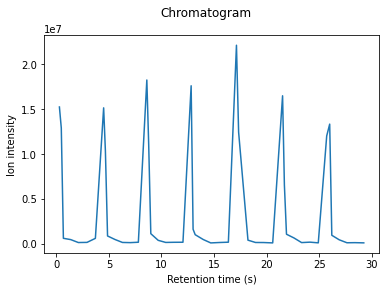

In [5]:
# get specific info of chromatogram

chromatogram_data = exp.getChromatogram(0).get_peaks()
print("Chromatogram data:",chromatogram_data)

# plot chromatogram (TIC)

plt.plot(chromatogram_data[0],chromatogram_data[1])
plt.xlabel('Retention time (s)')
plt.ylabel('Ion intensity')
plt.suptitle('Chromatogram')
plt.show()

In [6]:
# Calculates total ion current of an LC-MS/MS experiment

def calcTIC(exp, mslevel):
    tic = 0
    # Iterate through all spectra of the experiment
    for spec in exp:
        # Only calculate TIC for matching (MS1) spectra
        if spec.getMSLevel() == mslevel:
            mz, i = spec.get_peaks()
            tic += sum(i)
    return tic

# For spectra MS1
print ("Total ion current",calcTIC(exp, 2))

Total ion current 11505552.320386887


<div style="background-color:rgb(255, 250, 250); padding:5px; padding-left: 1em; padding-right: 1em;">

<h2 id="filterMS1" style="text-align: justify">Filter MS1 (optional)</h2>
    
Filtering MS1 level only, which will only keep MS1 spectra in the MSExperiment. We can then store the modified data structure on disk as <code>filtered_ms1.mzML</code>

In [7]:
exp_in = MSExperiment()
exp_out = MSExperiment()

MzMLFile().load("test.mzML", exp_in)

chromatogram = MSChromatogram()

spectra_list = list()
chr_rt = list()
chr_i = list()

for s in exp.getSpectra():
    ms_level = s.getMSLevel()
    if ms_level == 1:
        spectra_list.append(s)
        
        rt = s.getRT()
        i = np.max(s.get_peaks()[1])
        
        chr_rt.append(rt)
        chr_i.append(i)
        
chromatogram.set_peaks([chr_rt, chr_i])

exp_out.setSpectra(spectra_list)
exp_out.addChromatogram(chromatogram)

MzMLFile().store("filtered_ms1.mzML", exp_out)

<div style="background-color:rgb(255, 250, 250); padding:5px; padding-left: 1em; padding-right: 1em;">

Loading and previewing new filtered file

In [8]:
# load the new file
exp_filtered = MSExperiment()
MzMLFile().load("filtered_ms1.mzML", exp_filtered)
# inspecting the new file
print ("Number of spectra:", exp_filtered.getNrSpectra())

Number of spectra: 14


In [9]:
# plotting interactive MS1 spectra for spectra 1 (I couldn't add the slider here :/)
spectrum_data_1 = exp_filtered.getSpectrum(1).get_peaks()
fig = go.Figure()
fig.add_trace(go.Scatter(x=spectrum_data_1[0],y=spectrum_data_1[1]))
fig.update_layout(
    title={
        'text': "MS1 spectra",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    xaxis_title="m/z",
    yaxis_title="Intensity",
    hovermode="x",
    xaxis=dict(
        rangeslider=dict(
            visible=True
        ),
        type="linear"
    )
)
fig.show()

In [10]:
# plotting interactive MS1 spectra for spectra 1 (I couldn't add the slider here :/)
spectrum_data_1 = exp_filtered.getSpectrum(1).get_peaks()
fig1 = go.Figure()
fig1.add_trace(go.Scatter(x=spectrum_data_1[0],y=spectrum_data_1[1]))
fig1.update_layout(
    title={
        'text': "MS1 spectra",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    xaxis_title="m/z",
    yaxis_title="Intensity",
    )

num_spectra = int(exp_filtered.getNrSpectra())

def update (MS1=0):
            spectrum_data_1 = exp_filtered.getSpectrum(MS1).get_peaks()
            fig1.data[1]["x"] = spectrum_data_1[0]
            fig1.data[1].y = spectrum_data_1[1]
            fig1.layout.xaxis.range = [5,10]
            fig1.show()
            
interact(update,MS1 = widgets.IntSlider(min=0, max=num_spectra-1, step=1, value=0))

interactive(children=(IntSlider(value=0, description='MS1', max=13), Output()), _dom_classes=('widget-interact…

<function __main__.update(MS1=0)>

In [11]:
# plotting interactive chromatogram (TIC) with MS1 spectra
chromatogram_data_1 = exp_filtered.getChromatogram(0).get_peaks()
fig = go.Figure(data=go.Scatter(x=chromatogram_data_1[0],y=chromatogram_data_1[1]))
fig.update_layout(hovermode="x")
fig.update_layout(
    title={
        'text': "Chromatogram",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    xaxis_title="Retention time (s)",
    yaxis_title="Intensity",
    xaxis=dict(
        rangeslider=dict(
            visible=True
        ),
        type="linear"
    )
)

In [12]:
# plotting interactive chromatogram (TIC) and MS with slider
#(It would be great if we can update the MS1 based on RT in the chromatogram)

fig1 = make_subplots(rows=2, cols=1, subplot_titles=["Chromatogram","MS spectrum"])

trace1 = go.Scatter(x = chromatogram_data_1[0],y = chromatogram_data_1[1],name = 'chromatogram')
trace2 = go.Scatter(x = spectrum_data_1[0],y = spectrum_data_1[1],name = 'MS Spectrum',)
fig1.add_trace(trace1, 1, 1)
fig1.add_trace(trace2, 2, 1)
fig1.update_layout(hovermode="x")

num_spectra = int(exp_filtered.getNrSpectra())

def update (MS=0):
            spectrum_data_1 = exp_filtered.getSpectrum(MS).get_peaks()
            fig1.data[1]["x"] = spectrum_data_1[0]
            fig1.data[1].y = spectrum_data_1[1]
            fig1.show()
            
interact(update,MS = widgets.IntSlider(min=0, max=num_spectra-1, step=1, value=0))



interactive(children=(IntSlider(value=0, description='MS', max=13), Output()), _dom_classes=('widget-interact'…

<function __main__.update(MS=0)>

In [48]:
x=[]
y=[]
z=[]

for spectrum in exp_filtered:
    for peak in spectrum:
        
        x.append(spectrum.getRT())
        y.append(peak.getMZ())
        z.append(peak.getIntensity())

fig = go.Figure()
fig.add_trace(go.Scatter3d(x=np.array(x), y=np.array(y), z=np.array(z)))
fig.update_layout(
    title={
        'text': "3D visualization",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.update_layout(scene = dict(
                    xaxis_title='Retention time',
                    yaxis_title='m/z',
                    zaxis_title='Intensity'),
                    width=700,
                    margin=dict(r=20, b=10, l=10, t=10))
fig.show()

In [46]:
help (fig.update_layout)

Help on method update_layout in module plotly.basedatatypes:

update_layout(dict1=None, overwrite=False, **kwargs) method of plotly.graph_objs._figure.Figure instance
    Update the properties of the figure's layout with a dict and/or with
    keyword arguments.
    
    This recursively updates the structure of the original
    layout with the values in the input dict / keyword arguments.
    
    Parameters
    ----------
    dict1 : dict
        Dictionary of properties to be updated
    overwrite: bool
        If True, overwrite existing properties. If False, apply updates
        to existing properties recursively, preserving existing
        properties that are not specified in the update operation.
    kwargs :
        Keyword/value pair of properties to be updated
    
    Returns
    -------
    BaseFigure
        The Figure object that the update_layout method was called on



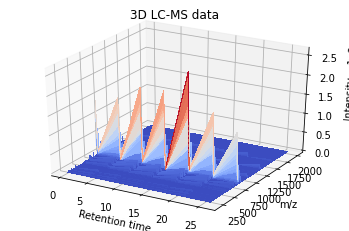

In [14]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

x=[]
y=[]
z=[]

for spectrum in exp_filtered:
    for peak in spectrum:
        
        x.append(spectrum.getRT())
        y.append(peak.getMZ())
        z.append(peak.getIntensity())

ax.plot_trisurf(np.array(x), np.array(y), np.array(z), cmap=cm.coolwarm, linewidth=0, antialiased=False)

ax.set_xlabel("Retention time")
ax.set_ylabel("m/z")
ax.set_zlabel("Intensity")

plt.title("3D LC-MS data")

fig.show()

In [15]:
fig = make_subplots(rows=2, cols=1, subplot_titles=["Chromatogram","MS spectrum"])

exp = MSExperiment()
MzMLFile().load("test.mzML", exp)

chromatogram_data = exp.getChromatogram(0).get_peaks()
spectrum_data = exp.getSpectrum(0).get_peaks()

trace1 = go.Scatter(x = chromatogram_data[0],y = chromatogram_data[1],name = 'chromatogram',)
trace2 = go.Scatter(x = spectrum_data[0],y = spectrum_data[1],name = 'MS Spectrum',)
fig.add_trace(trace1, 1, 1)
fig.add_trace(trace2, 2, 1)

num_spectra = int(exp_filtered.getNrSpectra())

def update (b=0):
    if b =='MS1':
        def update(MS1_Spectra=0):
            spectrum_data = exp.getSpectrum(MS1_Spectra).get_peaks()
            fig.data[1]["x"] = spectrum_data[0]
            fig.data[1].y = spectrum_data[1]
            fig.layout.xaxis.range = [5,10]
            fig.show()
        interact(update,MS1_Spectra = widgets.IntSlider(min=-0, max=num_spectra-1, step=1, value=0))



For MS2 spectra we can also create a different file and follow the same steps as MS1 data

In [16]:
exp_in = MSExperiment()
exp_out = MSExperiment()

MzMLFile().load("test.mzML", exp_in)

chromatogram = MSChromatogram()

spectra_list = list()
chr_rt = list()
chr_i = list()

for s in exp.getSpectra():
    ms_level = s.getMSLevel()
    if ms_level == 2:
        spectra_list.append(s)
        
        rt = s.getRT()
        i = np.max(s.get_peaks()[1])
        
        chr_rt.append(rt)
        chr_i.append(i)
        
chromatogram.set_peaks([chr_rt, chr_i])

exp_out.setSpectra(spectra_list)
exp_out.addChromatogram(chromatogram)

MzMLFile().store("filtered_ms2.mzML", exp_out)

Dropdown

In [17]:
#Imports Necessary Tools for Widgets in Plotly
from plotly.subplots import make_subplots
from ipywidgets import interact
import ipywidgets as widgets

In [18]:
#Makes Figure 1 of MS1 Data
fig1 = make_subplots(rows=2, cols=1)
exp_filtered_1 = MSExperiment()
MzMLFile().load("filtered_ms1.mzML", exp_filtered_1)
chromatogram_data_1 = exp_filtered_1.getChromatogram(0).get_peaks()
spectrum_data_1 = exp_filtered_1.getSpectrum(0).get_peaks()
trace1 = go.Scatter(x = chromatogram_data_1[0],y = chromatogram_data_1[1],name = 'chromatogram',)
trace2 = go.Scatter(x = spectrum_data_1[0],y = spectrum_data_1[1],name = 'MS Spectrum',)
fig1.add_trace(trace1, 1, 1)
fig1.add_trace(trace2, 2, 1)

#Makes Figure 2 of MS2 Data
fig2 = make_subplots(rows=2, cols=1)
exp_filtered_2 = MSExperiment()
MzMLFile().load("filtered_ms2.mzML", exp_filtered_2)
chromatogram_data_2 = exp_filtered_2.getChromatogram(0).get_peaks()
spectrum_data_2 = exp_filtered_2.getSpectrum(0).get_peaks()
trace3 = go.Scatter(x = chromatogram_data_2[0],y = chromatogram_data_2[1],name = 'MS2 chromatogram', visible = True,)
trace4 = go.Scatter(x = spectrum_data_2[0],y = spectrum_data_2[1],name = 'MS 2 Spectrum', visible = True,)
fig2.add_trace(trace3, 1, 1)
fig2.add_trace(trace4, 2, 1)

#Counts Spectra to Determine Slider Boundaries
num_spectra_1 = int(exp_filtered_1.getNrSpectra())
num_spectra_2 = int(exp_filtered_2.getNrSpectra())

#Makes Figure 3 of MS1 and MS2 Overlapped data
fig3 = make_subplots(rows=2, cols=1)
fig3.add_trace(trace3, 1, 1)
fig3.add_trace(trace4, 2, 1)
fig3.add_trace(trace1, 1, 1)
fig3.add_trace(trace2, 2, 1)

#Defines Spectra layout via slider value for MS1
def update1 (b=0):
    if b =='MS1':
        def update(MS1_Spectra =0):
            spectrum_data_1 = exp_filtered_1.getSpectrum(MS1_Spectra).get_peaks()
            fig1.data[1]["x"] = spectrum_data_1[0]
            fig1.data[1].y = spectrum_data_1[1]
            fig1.layout.xaxis.range = [5,10]
            fig1.show()
        interact(update,MS1_Spectra = widgets.IntSlider(min=-0, max=num_spectra-1, step=1, value=0))

#Defines Spectra layout via slider value for MS2    
    if b == 'MS2':
        def update3(MS2_Spectra=0):
            spectrum_data_2 = exp_filtered_2.getSpectrum(MS2_Spectra).get_peaks()
            fig2.data[1]["x"] = spectrum_data_2[0]
            fig2.data[1].y = spectrum_data_2[1]
            fig2.layout.xaxis.range = [5,10]
            fig2.show()
        interact(update3,MS2_Spectra= widgets.IntSlider(min=0, max=num_spectra_2-1, step=1, value=0))
        
 #Displays Figure 3 with no slider ***WILL EDIT IF MIKE WANTS SLIDER BUT NEED TO KNOW BOUNDS***  
    if b == 'MS1 & MS2':
        fig3.show()
        
#Defines Dropdown Widget Options
interact(update1,b= widgets.Dropdown(
    options=['MS1', 'MS2', 'MS1 & MS2'],
    value='MS1',
    description='MS View:',
    disabled=False,
))

interactive(children=(Dropdown(description='MS View:', options=('MS1', 'MS2', 'MS1 & MS2'), value='MS1'), Outp…

<function __main__.update1(b=0)>